## Swarm A/B conjunction points

This demo notebooks shows Swarm A/B conjunction points rerieval from the VirES server

In [1]:
SERVER_URL = "https://staging.viresdisc.vires.services/ows"

In [2]:
! pip install --upgrade --no-deps --force-reinstall 'git+https://github.com/ESA-VirES/VirES-Python-Client@swarm_ab_conjunctions#egg=viresclient'

  Cloning https://github.com/ESA-VirES/VirES-Python-Client (to revision swarm_ab_conjunctions) to /tmp/pip-install-84ntj7fa/viresclient_4f79337835a94328b9f1c93ef0648db9
  Running command git clone -q https://github.com/ESA-VirES/VirES-Python-Client /tmp/pip-install-84ntj7fa/viresclient_4f79337835a94328b9f1c93ef0648db9
  Running command git checkout -b swarm_ab_conjunctions --track origin/swarm_ab_conjunctions
  Switched to a new branch 'swarm_ab_conjunctions'
  Branch 'swarm_ab_conjunctions' set up to track remote branch 'swarm_ab_conjunctions' from 'origin'.
  Resolved https://github.com/ESA-VirES/VirES-Python-Client to commit eda8eff80d46ca05107081cf85e08d71ea17675c
  Created wheel for viresclient: filename=viresclient-0.9.1_dev_conjunctions-py3-none-any.whl size=75216 sha256=92816501f1dfe622faf792d75c8eaaae6eda8d3fea7b67f2181dbc52ba131f40
  Stored in directory: /tmp/pip-ephem-wheel-cache-m636e0b8/wheels/f3/c5/42/69d1ef320f075cb169b11af9af96eff674cbf78974e0480fb2
Failed to build vire

In [3]:
from collections import namedtuple
from numpy import timedelta64
from viresclient import SwarmRequest


def get_swarm_ab_conjunctions(start_time, end_time, threshold=1.0):
    """ Retrieve Swarm-A/B conjunctions times. """
    print(f"Retrieving Swarm A/B conjunction times from {start_time} to {end_time}, angular separation < {threshold} deg ... ")
    request = SwarmRequest(SERVER_URL)
    return xarray_to_tuple(request.get_conjunctions(
        start_time=start_time,
        end_time=end_time,
        threshold=threshold,
    ).as_xarray())


def get_swarm_abc_data(start_time, end_time, **opts): 
    return (
        get_swarm_data('A', start_time, end_time, **opts),
        get_swarm_data('B', start_time, end_time, **opts),
        get_swarm_data('C', start_time, end_time, **opts),
    )


def get_swarm_data(spacecraft, start_time, end_time, collection, asynchronous=False, **opts):
    "Retrieve Swarm MAG measurements for the given time-interval from the VirES server."
    collection = collection.format(spacecraft=spacecraft)
    print(f"Retrieving Swarm {collection} data from {start_time} to {end_time} ... ")
    request = SwarmRequest(SERVER_URL)
    request.set_collection(collection.format(spacecraft=spacecraft))
    request.set_products(
        measurements=['B_NEC'],
        models=['CHAOS'],
        auxiliaries=['QDLat', 'MLT'],
        **opts
    )
    return xarray_to_tuple(request.get_between(
        start_time=start_time,
        end_time=end_time,
        asynchronous=asynchronous,
    ).as_xarray())


def xarray_to_tuple(data):
    return namedtuple("SwarmData", [name.lower() for name in data.variables])(*[
        data[name].values  for name in data.variables
    ])


def get_time_window(centre, width):
    width = width.astype('timedelta64[us]')
    return str(centre - width/2), str(centre + width/2)


In [4]:
from matplotlib.pyplot import figure, subplot
from cartopy.feature import LAND, OCEAN, COASTLINE
from cartopy.crs import Mollweide, Orthographic, PlateCarree
from eoxmagmod import vnorm

def plot_conjunction_map(conjunction_time, angular_separation, data_a, data_b, data_c):
    if data_a.timestamp.size == 0:
        print(f'No data available at {conjunction_time}!')
        return
    
    idx_a = abs(data_a.timestamp - conjunction_time).argmin()
    conjunction_mlt = data_a.mlt[idx_a]
    
    fig = figure(figsize=(9, 9), dpi=100, constrained_layout=True)
    ax = subplot(1, 1, 1, projection=Orthographic(data_a.longitude[idx_a], data_a.latitude[idx_a]))
    ax.set_title(f"Swarm A/B Conjunction @ {conjunction_time.astype('datetime64[s]')} (Δ{angular_separation:.2f}deg, MLT {conjunction_mlt:.1f}h) - MAGx_HR_1B")
    gl = ax.gridlines(crs=PlateCarree(), draw_labels=False, linewidth=1, color='silver', alpha=0.5, linestyle='--')
    ext = 6378073.21863
    ax.set_xlim([-ext, +ext])
    ax.set_ylim([-ext, +ext])
    ax.add_feature(LAND, facecolor=(1.0, 1.0, 0.9))
    ax.add_feature(OCEAN, facecolor=(0.9, 1.0, 1.0))
    ax.add_feature(COASTLINE, edgecolor='silver')
    
    h_a, = ax.plot(data_c.longitude, data_c.latitude, color='tab:green', transform=PlateCarree())
    h_b, = ax.plot(data_a.longitude, data_a.latitude, color='tab:blue', transform=PlateCarree())
    h_c, = ax.plot(data_b.longitude, data_b.latitude, color='tab:red', transform=PlateCarree())
    h_x, = ax.plot(data_a.longitude[idx_a], data_c.latitude[idx_a], 'ok', mfc='none', transform=PlateCarree())


def plot_conjunction_qdlat(conjunction_time, angular_separation, data_a, data_b, data_c):
    
    if data_a.timestamp.size == 0:
        print(f'No data available at {conjunction_time}!')
        return
    
    idx_a = abs(data_a.timestamp - conjunction_time).argmin()
    conjunction_qdlat = data_a.qdlat[idx_a]
    conjunction_mlt = data_a.mlt[idx_a]
    
    fig = figure(figsize=(12, 12), dpi=100, constrained_layout=True)
    fig.suptitle(f"Swarm A/B Conjunction @ {conjunction_time.astype('datetime64[s]')} (Δ{angular_separation:.2f}deg, MLT {conjunction_mlt:.1f}h) - MAGx_HR_1B")
    
    ax = subplot(4, 1, 1)
    ax.grid()
    ax.set_ylabel('B_N - B_N_CHAOS / nT')
    ax.set_xlabel('QD-latitude / deg')
    h_a, = ax.plot(data_a.qdlat, data_a.b_nec[:,0] - data_a.b_nec_chaos[:,0], '-', color='tab:blue')
    h_b, = ax.plot(data_b.qdlat, data_b.b_nec[:,0] - data_b.b_nec_chaos[:,0], '-', color='tab:red')
    h_c, = ax.plot(data_c.qdlat, data_c.b_nec[:,0] - data_c.b_nec_chaos[:,0], '-', color='tab:green')
    ylim = ax.get_ylim(); ax.set_ylim(*ylim)
    h_x, = ax.plot([conjunction_qdlat, conjunction_qdlat], ylim, ':k')
    ax.legend([h_a, h_b, h_c, h_x], ['Swarm-A', 'Swarm-B', 'Swarm-C', 'Swarm-A/B conjunction'])
    
    ax = subplot(4, 1, 2)
    ax.grid()
    ax.set_ylabel('B_E - B_E_CHAOS / nT')
    ax.set_xlabel('QD-latitude / deg')
    h_a, = ax.plot(data_a.qdlat, data_a.b_nec[:,1] - data_a.b_nec_chaos[:,1], '-', color='tab:blue')
    h_b, = ax.plot(data_b.qdlat, data_b.b_nec[:,1] - data_b.b_nec_chaos[:,1], '-', color='tab:red')
    h_c, = ax.plot(data_c.qdlat, data_c.b_nec[:,1] - data_c.b_nec_chaos[:,1], '-', color='tab:green')
    ylim = ax.get_ylim(); ax.set_ylim(*ylim)
    h_x, = ax.plot([conjunction_qdlat, conjunction_qdlat], ylim, ':k')
    ax.legend([h_a, h_b, h_c, h_x], ['Swarm-A', 'Swarm-B', 'Swarm-C', 'Swarm-A/B conjunction'])

    ax = subplot(4, 1, 3)
    ax.grid()
    ax.set_ylabel('B_C - B_C_CHAOS / nT')
    ax.set_xlabel('QD-latitude / deg')
    h_a, = ax.plot(data_a.qdlat, data_a.b_nec[:,2] - data_a.b_nec_chaos[:,2], '-', color='tab:blue')
    h_b, = ax.plot(data_b.qdlat, data_b.b_nec[:,2] - data_b.b_nec_chaos[:,2], '-', color='tab:red')
    h_c, = ax.plot(data_c.qdlat, data_c.b_nec[:,2] - data_c.b_nec_chaos[:,2], '-', color='tab:green')
    ylim = ax.get_ylim(); ax.set_ylim(*ylim)
    h_x, = ax.plot([conjunction_qdlat, conjunction_qdlat], ylim, ':k')
    ax.legend([h_a, h_b, h_c, h_x], ['Swarm-A', 'Swarm-B', 'Swarm-C', 'Swarm-A/B conjunction'])

    ax = subplot(4, 1, 4)
    ax.grid()
    ax.set_ylabel('|B_NEC| - |B_NEC_CHAOS| / nT')
    ax.set_xlabel('QD-latitude / deg')
    h_a, = ax.plot(data_a.qdlat, vnorm(data_a.b_nec) - vnorm(data_a.b_nec_chaos), '-', color='tab:blue')
    h_b, = ax.plot(data_b.qdlat, vnorm(data_b.b_nec) - vnorm(data_b.b_nec_chaos), '-', color='tab:red')
    h_c, = ax.plot(data_c.qdlat, vnorm(data_c.b_nec) - vnorm(data_c.b_nec_chaos), '-', color='tab:green')
    ylim = ax.get_ylim(); ax.set_ylim(*ylim)
    h_x, = ax.plot([conjunction_qdlat, conjunction_qdlat], ylim, ':k')
    ax.legend([h_a, h_b, h_c, h_x], ['Swarm-A', 'Swarm-B', 'Swarm-C', 'Swarm-A/B conjunction'])



def plot_conjunction_time(conjunction_time, angular_separation, data_a, data_b, data_c):
    
    if data_a.timestamp.size == 0:
        print(f'No data available at {conjunction_time}!')
        return
    
    idx_a = abs(data_a.timestamp - conjunction_time).argmin()
    conjunction_mlt = data_a.mlt[idx_a]
    
    fig = figure(figsize=(12, 12), dpi=100, constrained_layout=True)
    fig.suptitle(f"Swarm A/B Conjunction @ {conjunction_time.astype('datetime64[s]')} (Δ{angular_separation:.2f}deg, MLT {conjunction_mlt:.1f}h) - MAGx_HR_1B")
    
    ax = subplot(4, 1, 1)
    ax.grid()
    ax.set_ylabel('B_N - B_N_CHAOS / nT')
    ax.set_xlabel('time')
    h_a, = ax.plot(data_a.timestamp, data_a.b_nec[:,0] - data_a.b_nec_chaos[:,0], '-', color='tab:blue')
    h_b, = ax.plot(data_b.timestamp, data_b.b_nec[:,0] - data_b.b_nec_chaos[:,0], '-', color='tab:red')
    h_c, = ax.plot(data_c.timestamp, data_c.b_nec[:,0] - data_c.b_nec_chaos[:,0], '-', color='tab:green')
    ylim = ax.get_ylim(); ax.set_ylim(*ylim)
    h_x, = ax.plot([conjunction_time, conjunction_time], ylim, ':k')
    ax.legend([h_a, h_b, h_c, h_x], ['Swarm-A', 'Swarm-B', 'Swarm-C', 'Swarm-A/B conjunction'])
    
    ax = subplot(4, 1, 2)
    ax.grid()
    ax.set_ylabel('B_E - B_E_CHAOS / nT')
    ax.set_xlabel('time')
    h_a, = ax.plot(data_a.timestamp, data_a.b_nec[:,1] - data_a.b_nec_chaos[:,1], '-', color='tab:blue')
    h_b, = ax.plot(data_b.timestamp, data_b.b_nec[:,1] - data_b.b_nec_chaos[:,1], '-', color='tab:red')
    h_c, = ax.plot(data_c.timestamp, data_c.b_nec[:,1] - data_c.b_nec_chaos[:,1], '-', color='tab:green')
    ylim = ax.get_ylim(); ax.set_ylim(*ylim)
    h_x, = ax.plot([conjunction_time, conjunction_time], ylim, ':k')
    ax.legend([h_a, h_b, h_c, h_x], ['Swarm-A', 'Swarm-B', 'Swarm-C', 'Swarm-A/B conjunction'])

    ax = subplot(4, 1, 3)
    ax.grid()
    ax.set_ylabel('B_C - B_C_CHAOS / nT')
    ax.set_xlabel('time')
    h_a, = ax.plot(data_a.timestamp, data_a.b_nec[:,2] - data_a.b_nec_chaos[:,2], '-', color='tab:blue')
    h_b, = ax.plot(data_b.timestamp, data_b.b_nec[:,2] - data_b.b_nec_chaos[:,2], '-', color='tab:red')
    h_c, = ax.plot(data_c.timestamp, data_c.b_nec[:,2] - data_c.b_nec_chaos[:,2], '-', color='tab:green')
    ylim = ax.get_ylim(); ax.set_ylim(*ylim)
    h_x, = ax.plot([conjunction_time, conjunction_time], ylim, ':k')
    ax.legend([h_a, h_b, h_c, h_x], ['Swarm-A', 'Swarm-B', 'Swarm-C', 'Swarm-A/B conjunction'])

    ax = subplot(4, 1, 4)
    ax.grid()
    ax.set_ylabel('|B_NEC| - |B_NEC_CHAOS| / nT')
    ax.set_xlabel('time')
    h_a, = ax.plot(data_a.timestamp, vnorm(data_a.b_nec) - vnorm(data_a.b_nec_chaos), '-', color='tab:blue')
    h_b, = ax.plot(data_b.timestamp, vnorm(data_b.b_nec) - vnorm(data_b.b_nec_chaos), '-', color='tab:red')
    h_c, = ax.plot(data_c.timestamp, vnorm(data_c.b_nec) - vnorm(data_c.b_nec_chaos), '-', color='tab:green')
    ylim = ax.get_ylim(); ax.set_ylim(*ylim)
    h_x, = ax.plot([conjunction_time, conjunction_time], ylim, ':k')
    ax.legend([h_a, h_b, h_c, h_x], ['Swarm-A', 'Swarm-B', 'Swarm-C', 'Swarm-A/B conjunction'])


/opt/conda/lib/python3.8/site-packages/spacepy/time.py:2294: UserWarning: Leapseconds may be out of date. Use spacepy.toolbox.update(leapsecs=True)
  warnings.warn('Leapseconds may be out of date.'


### Load conjunctions ...

In [5]:
start_time, end_time = "2021-07-01T00:00Z", "2022-01-01T00:00Z"

conjunctions_ab = get_swarm_ab_conjunctions(start_time, end_time, threshold=0.1)

print("Conj")
for conjunction_time, angular_separation in zip(conjunctions_ab.timestamp, conjunctions_ab.angularseparation):
    print(f"{conjunction_time.astype('datetime64[s]')}Z\t{angular_separation:.2f}")


Retrieving Swarm A/B conjunction times from 2021-07-01T00:00Z to 2022-01-01T00:00Z, angular separation < 0.1 deg ... 


Downloading:   0%|          |  [ Elapsed: 00:00, Remaining: ? ] (0.036MB)

Conj
2021-07-02T18:14:54Z	0.06
2021-07-07T00:48:16Z	0.08
2021-07-11T06:34:39Z	0.05
2021-07-15T13:07:58Z	0.04
2021-07-19T19:41:15Z	0.08
2021-07-24T01:27:31Z	0.08
2021-07-28T08:00:43Z	0.04
2021-08-01T13:46:55Z	0.09
2021-08-01T14:33:53Z	0.05
2021-08-05T20:20:02Z	0.05
2021-08-05T21:07:00Z	0.07
2021-08-10T02:53:07Z	0.02
2021-08-14T09:26:10Z	0.03
2021-08-18T15:59:11Z	0.06
2021-08-22T21:45:12Z	0.09
2021-08-22T22:32:10Z	0.08
2021-08-27T04:18:09Z	0.08
2021-08-31T10:51:03Z	0.07
2021-09-04T17:23:53Z	0.03
2021-09-08T23:56:41Z	0.02
2021-09-13T05:42:27Z	0.09
2021-09-13T06:29:25Z	0.06
2021-09-17T12:15:08Z	0.06
2021-09-17T13:02:06Z	0.05


### Load load data 30s of MAGx_HR_1B before and after each conjunction ...

In [6]:
time_window_width = timedelta64(60, 's')

data = [
    namedtuple('Data', ['conjunction_time', 'anular_separation', 'data_a', 'data_b', 'data_c'])(
        conjunction_time, angular_separation,
        *get_swarm_abc_data(
            *get_time_window(conjunction_time, time_window_width),
            collection="SW_OPER_MAG{spacecraft}_HR_1B"
        )
    )
    for conjunction_time, angular_separation in zip(conjunctions_ab.timestamp, conjunctions_ab.angularseparation)
]

Retrieving Swarm SW_OPER_MAGA_HR_1B data from 2021-07-02T18:14:24.000000000 to 2021-07-02T18:15:24.000000000 ... 


Downloading:   0%|          |  [ Elapsed: 00:00, Remaining: ? ] (0.302MB)

Retrieving Swarm SW_OPER_MAGB_HR_1B data from 2021-07-02T18:14:24.000000000 to 2021-07-02T18:15:24.000000000 ... 


Downloading:   0%|          |  [ Elapsed: 00:00, Remaining: ? ] (0.302MB)

Retrieving Swarm SW_OPER_MAGC_HR_1B data from 2021-07-02T18:14:24.000000000 to 2021-07-02T18:15:24.000000000 ... 


Downloading:   0%|          |  [ Elapsed: 00:00, Remaining: ? ] (0.302MB)

Retrieving Swarm SW_OPER_MAGA_HR_1B data from 2021-07-07T00:47:46.000000000 to 2021-07-07T00:48:46.000000000 ... 


Downloading:   0%|          |  [ Elapsed: 00:00, Remaining: ? ] (0.302MB)

Retrieving Swarm SW_OPER_MAGB_HR_1B data from 2021-07-07T00:47:46.000000000 to 2021-07-07T00:48:46.000000000 ... 


Downloading:   0%|          |  [ Elapsed: 00:00, Remaining: ? ] (0.302MB)

Retrieving Swarm SW_OPER_MAGC_HR_1B data from 2021-07-07T00:47:46.000000000 to 2021-07-07T00:48:46.000000000 ... 


Downloading:   0%|          |  [ Elapsed: 00:00, Remaining: ? ] (0.302MB)

Retrieving Swarm SW_OPER_MAGA_HR_1B data from 2021-07-11T06:34:09.000000000 to 2021-07-11T06:35:09.000000000 ... 


Downloading:   0%|          |  [ Elapsed: 00:00, Remaining: ? ] (0.302MB)

Retrieving Swarm SW_OPER_MAGB_HR_1B data from 2021-07-11T06:34:09.000000000 to 2021-07-11T06:35:09.000000000 ... 


Downloading:   0%|          |  [ Elapsed: 00:00, Remaining: ? ] (0.302MB)

Retrieving Swarm SW_OPER_MAGC_HR_1B data from 2021-07-11T06:34:09.000000000 to 2021-07-11T06:35:09.000000000 ... 


Downloading:   0%|          |  [ Elapsed: 00:00, Remaining: ? ] (0.302MB)

Retrieving Swarm SW_OPER_MAGA_HR_1B data from 2021-07-15T13:07:28.000000000 to 2021-07-15T13:08:28.000000000 ... 


Downloading:   0%|          |  [ Elapsed: 00:00, Remaining: ? ] (0.302MB)

Retrieving Swarm SW_OPER_MAGB_HR_1B data from 2021-07-15T13:07:28.000000000 to 2021-07-15T13:08:28.000000000 ... 


Downloading:   0%|          |  [ Elapsed: 00:00, Remaining: ? ] (0.302MB)

Retrieving Swarm SW_OPER_MAGC_HR_1B data from 2021-07-15T13:07:28.000000000 to 2021-07-15T13:08:28.000000000 ... 


Downloading:   0%|          |  [ Elapsed: 00:00, Remaining: ? ] (0.302MB)

Retrieving Swarm SW_OPER_MAGA_HR_1B data from 2021-07-19T19:40:45.000000000 to 2021-07-19T19:41:45.000000000 ... 


Downloading:   0%|          |  [ Elapsed: 00:00, Remaining: ? ] (0.302MB)

Retrieving Swarm SW_OPER_MAGB_HR_1B data from 2021-07-19T19:40:45.000000000 to 2021-07-19T19:41:45.000000000 ... 


Downloading:   0%|          |  [ Elapsed: 00:00, Remaining: ? ] (0.302MB)

Retrieving Swarm SW_OPER_MAGC_HR_1B data from 2021-07-19T19:40:45.000000000 to 2021-07-19T19:41:45.000000000 ... 


Downloading:   0%|          |  [ Elapsed: 00:00, Remaining: ? ] (0.302MB)

Retrieving Swarm SW_OPER_MAGA_HR_1B data from 2021-07-24T01:27:01.000000000 to 2021-07-24T01:28:01.000000000 ... 


Downloading:   0%|          |  [ Elapsed: 00:00, Remaining: ? ] (0.005MB)

Retrieving Swarm SW_OPER_MAGB_HR_1B data from 2021-07-24T01:27:01.000000000 to 2021-07-24T01:28:01.000000000 ... 


Downloading:   0%|          |  [ Elapsed: 00:00, Remaining: ? ] (0.302MB)

Retrieving Swarm SW_OPER_MAGC_HR_1B data from 2021-07-24T01:27:01.000000000 to 2021-07-24T01:28:01.000000000 ... 


Downloading:   0%|          |  [ Elapsed: 00:00, Remaining: ? ] (0.302MB)

Retrieving Swarm SW_OPER_MAGA_HR_1B data from 2021-07-28T08:00:13.000000000 to 2021-07-28T08:01:13.000000000 ... 


Downloading:   0%|          |  [ Elapsed: 00:00, Remaining: ? ] (0.302MB)

Retrieving Swarm SW_OPER_MAGB_HR_1B data from 2021-07-28T08:00:13.000000000 to 2021-07-28T08:01:13.000000000 ... 


Downloading:   0%|          |  [ Elapsed: 00:00, Remaining: ? ] (0.302MB)

Retrieving Swarm SW_OPER_MAGC_HR_1B data from 2021-07-28T08:00:13.000000000 to 2021-07-28T08:01:13.000000000 ... 


Downloading:   0%|          |  [ Elapsed: 00:00, Remaining: ? ] (0.302MB)

Retrieving Swarm SW_OPER_MAGA_HR_1B data from 2021-08-01T13:46:25.000000000 to 2021-08-01T13:47:25.000000000 ... 


Downloading:   0%|          |  [ Elapsed: 00:00, Remaining: ? ] (0.302MB)

Retrieving Swarm SW_OPER_MAGB_HR_1B data from 2021-08-01T13:46:25.000000000 to 2021-08-01T13:47:25.000000000 ... 


Downloading:   0%|          |  [ Elapsed: 00:00, Remaining: ? ] (0.302MB)

Retrieving Swarm SW_OPER_MAGC_HR_1B data from 2021-08-01T13:46:25.000000000 to 2021-08-01T13:47:25.000000000 ... 


Downloading:   0%|          |  [ Elapsed: 00:00, Remaining: ? ] (0.302MB)

Retrieving Swarm SW_OPER_MAGA_HR_1B data from 2021-08-01T14:33:23.000000000 to 2021-08-01T14:34:23.000000000 ... 


Downloading:   0%|          |  [ Elapsed: 00:00, Remaining: ? ] (0.302MB)

Retrieving Swarm SW_OPER_MAGB_HR_1B data from 2021-08-01T14:33:23.000000000 to 2021-08-01T14:34:23.000000000 ... 


Downloading:   0%|          |  [ Elapsed: 00:00, Remaining: ? ] (0.302MB)

Retrieving Swarm SW_OPER_MAGC_HR_1B data from 2021-08-01T14:33:23.000000000 to 2021-08-01T14:34:23.000000000 ... 


Downloading:   0%|          |  [ Elapsed: 00:00, Remaining: ? ] (0.302MB)

Retrieving Swarm SW_OPER_MAGA_HR_1B data from 2021-08-05T20:19:32.000000000 to 2021-08-05T20:20:32.000000000 ... 


Downloading:   0%|          |  [ Elapsed: 00:00, Remaining: ? ] (0.302MB)

Retrieving Swarm SW_OPER_MAGB_HR_1B data from 2021-08-05T20:19:32.000000000 to 2021-08-05T20:20:32.000000000 ... 


Downloading:   0%|          |  [ Elapsed: 00:00, Remaining: ? ] (0.302MB)

Retrieving Swarm SW_OPER_MAGC_HR_1B data from 2021-08-05T20:19:32.000000000 to 2021-08-05T20:20:32.000000000 ... 


Downloading:   0%|          |  [ Elapsed: 00:00, Remaining: ? ] (0.302MB)

Retrieving Swarm SW_OPER_MAGA_HR_1B data from 2021-08-05T21:06:30.000000000 to 2021-08-05T21:07:30.000000000 ... 


Downloading:   0%|          |  [ Elapsed: 00:00, Remaining: ? ] (0.302MB)

Retrieving Swarm SW_OPER_MAGB_HR_1B data from 2021-08-05T21:06:30.000000000 to 2021-08-05T21:07:30.000000000 ... 


Downloading:   0%|          |  [ Elapsed: 00:00, Remaining: ? ] (0.302MB)

Retrieving Swarm SW_OPER_MAGC_HR_1B data from 2021-08-05T21:06:30.000000000 to 2021-08-05T21:07:30.000000000 ... 


Downloading:   0%|          |  [ Elapsed: 00:00, Remaining: ? ] (0.302MB)

Retrieving Swarm SW_OPER_MAGA_HR_1B data from 2021-08-10T02:52:37.000000000 to 2021-08-10T02:53:37.000000000 ... 


Downloading:   0%|          |  [ Elapsed: 00:00, Remaining: ? ] (0.302MB)

Retrieving Swarm SW_OPER_MAGB_HR_1B data from 2021-08-10T02:52:37.000000000 to 2021-08-10T02:53:37.000000000 ... 


Downloading:   0%|          |  [ Elapsed: 00:00, Remaining: ? ] (0.302MB)

Retrieving Swarm SW_OPER_MAGC_HR_1B data from 2021-08-10T02:52:37.000000000 to 2021-08-10T02:53:37.000000000 ... 


Downloading:   0%|          |  [ Elapsed: 00:00, Remaining: ? ] (0.302MB)

Retrieving Swarm SW_OPER_MAGA_HR_1B data from 2021-08-14T09:25:40.000000000 to 2021-08-14T09:26:40.000000000 ... 


Downloading:   0%|          |  [ Elapsed: 00:00, Remaining: ? ] (0.302MB)

Retrieving Swarm SW_OPER_MAGB_HR_1B data from 2021-08-14T09:25:40.000000000 to 2021-08-14T09:26:40.000000000 ... 


Downloading:   0%|          |  [ Elapsed: 00:00, Remaining: ? ] (0.302MB)

Retrieving Swarm SW_OPER_MAGC_HR_1B data from 2021-08-14T09:25:40.000000000 to 2021-08-14T09:26:40.000000000 ... 


Downloading:   0%|          |  [ Elapsed: 00:00, Remaining: ? ] (0.302MB)

Retrieving Swarm SW_OPER_MAGA_HR_1B data from 2021-08-18T15:58:41.000000000 to 2021-08-18T15:59:41.000000000 ... 


Downloading:   0%|          |  [ Elapsed: 00:00, Remaining: ? ] (0.302MB)

Retrieving Swarm SW_OPER_MAGB_HR_1B data from 2021-08-18T15:58:41.000000000 to 2021-08-18T15:59:41.000000000 ... 


Downloading:   0%|          |  [ Elapsed: 00:00, Remaining: ? ] (0.302MB)

Retrieving Swarm SW_OPER_MAGC_HR_1B data from 2021-08-18T15:58:41.000000000 to 2021-08-18T15:59:41.000000000 ... 


Downloading:   0%|          |  [ Elapsed: 00:00, Remaining: ? ] (0.302MB)

Retrieving Swarm SW_OPER_MAGA_HR_1B data from 2021-08-22T21:44:42.000000000 to 2021-08-22T21:45:42.000000000 ... 


Downloading:   0%|          |  [ Elapsed: 00:00, Remaining: ? ] (0.302MB)

Retrieving Swarm SW_OPER_MAGB_HR_1B data from 2021-08-22T21:44:42.000000000 to 2021-08-22T21:45:42.000000000 ... 


Downloading:   0%|          |  [ Elapsed: 00:00, Remaining: ? ] (0.302MB)

Retrieving Swarm SW_OPER_MAGC_HR_1B data from 2021-08-22T21:44:42.000000000 to 2021-08-22T21:45:42.000000000 ... 


Downloading:   0%|          |  [ Elapsed: 00:00, Remaining: ? ] (0.302MB)

Retrieving Swarm SW_OPER_MAGA_HR_1B data from 2021-08-22T22:31:40.000000000 to 2021-08-22T22:32:40.000000000 ... 


Downloading:   0%|          |  [ Elapsed: 00:00, Remaining: ? ] (0.302MB)

Retrieving Swarm SW_OPER_MAGB_HR_1B data from 2021-08-22T22:31:40.000000000 to 2021-08-22T22:32:40.000000000 ... 


Downloading:   0%|          |  [ Elapsed: 00:00, Remaining: ? ] (0.302MB)

Retrieving Swarm SW_OPER_MAGC_HR_1B data from 2021-08-22T22:31:40.000000000 to 2021-08-22T22:32:40.000000000 ... 


Downloading:   0%|          |  [ Elapsed: 00:00, Remaining: ? ] (0.302MB)

Retrieving Swarm SW_OPER_MAGA_HR_1B data from 2021-08-27T04:17:39.000000000 to 2021-08-27T04:18:39.000000000 ... 


Downloading:   0%|          |  [ Elapsed: 00:00, Remaining: ? ] (0.302MB)

Retrieving Swarm SW_OPER_MAGB_HR_1B data from 2021-08-27T04:17:39.000000000 to 2021-08-27T04:18:39.000000000 ... 


Downloading:   0%|          |  [ Elapsed: 00:00, Remaining: ? ] (0.302MB)

Retrieving Swarm SW_OPER_MAGC_HR_1B data from 2021-08-27T04:17:39.000000000 to 2021-08-27T04:18:39.000000000 ... 


Downloading:   0%|          |  [ Elapsed: 00:00, Remaining: ? ] (0.302MB)

Retrieving Swarm SW_OPER_MAGA_HR_1B data from 2021-08-31T10:50:33.000000000 to 2021-08-31T10:51:33.000000000 ... 


Downloading:   0%|          |  [ Elapsed: 00:00, Remaining: ? ] (0.302MB)

Retrieving Swarm SW_OPER_MAGB_HR_1B data from 2021-08-31T10:50:33.000000000 to 2021-08-31T10:51:33.000000000 ... 


Downloading:   0%|          |  [ Elapsed: 00:00, Remaining: ? ] (0.302MB)

Retrieving Swarm SW_OPER_MAGC_HR_1B data from 2021-08-31T10:50:33.000000000 to 2021-08-31T10:51:33.000000000 ... 


Downloading:   0%|          |  [ Elapsed: 00:00, Remaining: ? ] (0.302MB)

Retrieving Swarm SW_OPER_MAGA_HR_1B data from 2021-09-04T17:23:23.000000000 to 2021-09-04T17:24:23.000000000 ... 


Downloading:   0%|          |  [ Elapsed: 00:00, Remaining: ? ] (0.302MB)

Retrieving Swarm SW_OPER_MAGB_HR_1B data from 2021-09-04T17:23:23.000000000 to 2021-09-04T17:24:23.000000000 ... 


Downloading:   0%|          |  [ Elapsed: 00:00, Remaining: ? ] (0.302MB)

Retrieving Swarm SW_OPER_MAGC_HR_1B data from 2021-09-04T17:23:23.000000000 to 2021-09-04T17:24:23.000000000 ... 


Downloading:   0%|          |  [ Elapsed: 00:00, Remaining: ? ] (0.302MB)

Retrieving Swarm SW_OPER_MAGA_HR_1B data from 2021-09-08T23:56:11.000000000 to 2021-09-08T23:57:11.000000000 ... 


Downloading:   0%|          |  [ Elapsed: 00:00, Remaining: ? ] (0.302MB)

Retrieving Swarm SW_OPER_MAGB_HR_1B data from 2021-09-08T23:56:11.000000000 to 2021-09-08T23:57:11.000000000 ... 


Downloading:   0%|          |  [ Elapsed: 00:00, Remaining: ? ] (0.302MB)

Retrieving Swarm SW_OPER_MAGC_HR_1B data from 2021-09-08T23:56:11.000000000 to 2021-09-08T23:57:11.000000000 ... 


Downloading:   0%|          |  [ Elapsed: 00:00, Remaining: ? ] (0.302MB)

Retrieving Swarm SW_OPER_MAGA_HR_1B data from 2021-09-13T05:41:57.000000000 to 2021-09-13T05:42:57.000000000 ... 


Downloading:   0%|          |  [ Elapsed: 00:00, Remaining: ? ] (0.302MB)

Retrieving Swarm SW_OPER_MAGB_HR_1B data from 2021-09-13T05:41:57.000000000 to 2021-09-13T05:42:57.000000000 ... 


Downloading:   0%|          |  [ Elapsed: 00:00, Remaining: ? ] (0.302MB)

Retrieving Swarm SW_OPER_MAGC_HR_1B data from 2021-09-13T05:41:57.000000000 to 2021-09-13T05:42:57.000000000 ... 


Downloading:   0%|          |  [ Elapsed: 00:00, Remaining: ? ] (0.302MB)

Retrieving Swarm SW_OPER_MAGA_HR_1B data from 2021-09-13T06:28:55.000000000 to 2021-09-13T06:29:55.000000000 ... 


Downloading:   0%|          |  [ Elapsed: 00:00, Remaining: ? ] (0.302MB)

Retrieving Swarm SW_OPER_MAGB_HR_1B data from 2021-09-13T06:28:55.000000000 to 2021-09-13T06:29:55.000000000 ... 


Downloading:   0%|          |  [ Elapsed: 00:00, Remaining: ? ] (0.302MB)

Retrieving Swarm SW_OPER_MAGC_HR_1B data from 2021-09-13T06:28:55.000000000 to 2021-09-13T06:29:55.000000000 ... 


Downloading:   0%|          |  [ Elapsed: 00:00, Remaining: ? ] (0.302MB)

Retrieving Swarm SW_OPER_MAGA_HR_1B data from 2021-09-17T12:14:38.000000000 to 2021-09-17T12:15:38.000000000 ... 


Downloading:   0%|          |  [ Elapsed: 00:00, Remaining: ? ] (0.302MB)

Retrieving Swarm SW_OPER_MAGB_HR_1B data from 2021-09-17T12:14:38.000000000 to 2021-09-17T12:15:38.000000000 ... 


Downloading:   0%|          |  [ Elapsed: 00:00, Remaining: ? ] (0.302MB)

Retrieving Swarm SW_OPER_MAGC_HR_1B data from 2021-09-17T12:14:38.000000000 to 2021-09-17T12:15:38.000000000 ... 


Downloading:   0%|          |  [ Elapsed: 00:00, Remaining: ? ] (0.302MB)

Retrieving Swarm SW_OPER_MAGA_HR_1B data from 2021-09-17T13:01:36.000000000 to 2021-09-17T13:02:36.000000000 ... 


Downloading:   0%|          |  [ Elapsed: 00:00, Remaining: ? ] (0.302MB)

Retrieving Swarm SW_OPER_MAGB_HR_1B data from 2021-09-17T13:01:36.000000000 to 2021-09-17T13:02:36.000000000 ... 


Downloading:   0%|          |  [ Elapsed: 00:00, Remaining: ? ] (0.302MB)

Retrieving Swarm SW_OPER_MAGC_HR_1B data from 2021-09-17T13:01:36.000000000 to 2021-09-17T13:02:36.000000000 ... 


Downloading:   0%|          |  [ Elapsed: 00:00, Remaining: ? ] (0.302MB)

### Plot data ...

No data available at 2021-07-24T01:27:31.000000000!
No data available at 2021-07-24T01:27:31.000000000!
No data available at 2021-07-24T01:27:31.000000000!


<ipython-input-4-19378459eab4>:41: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = figure(figsize=(12, 12), dpi=100, constrained_layout=True)


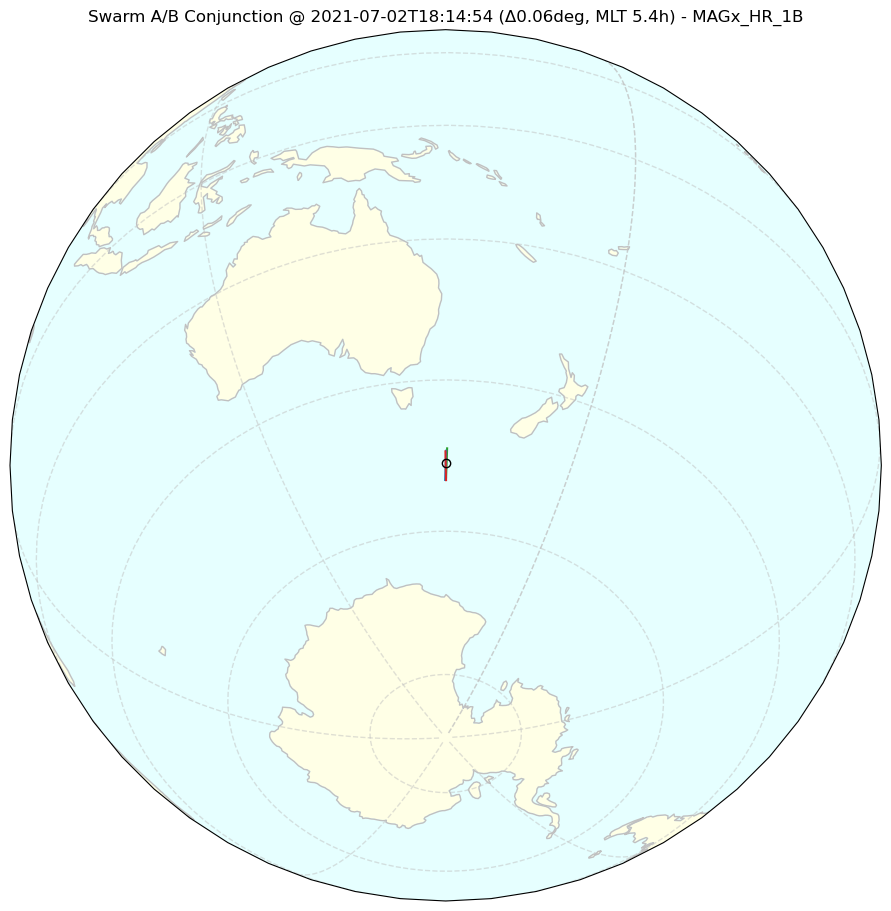

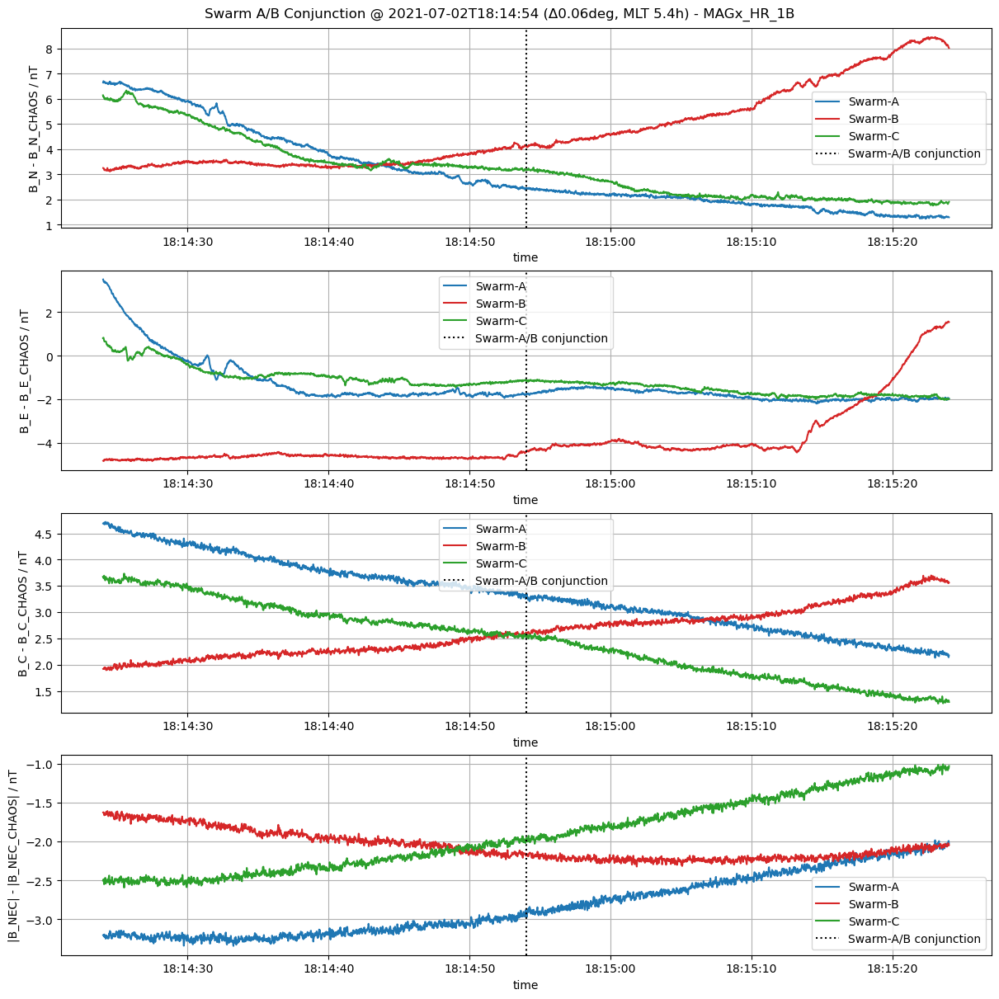

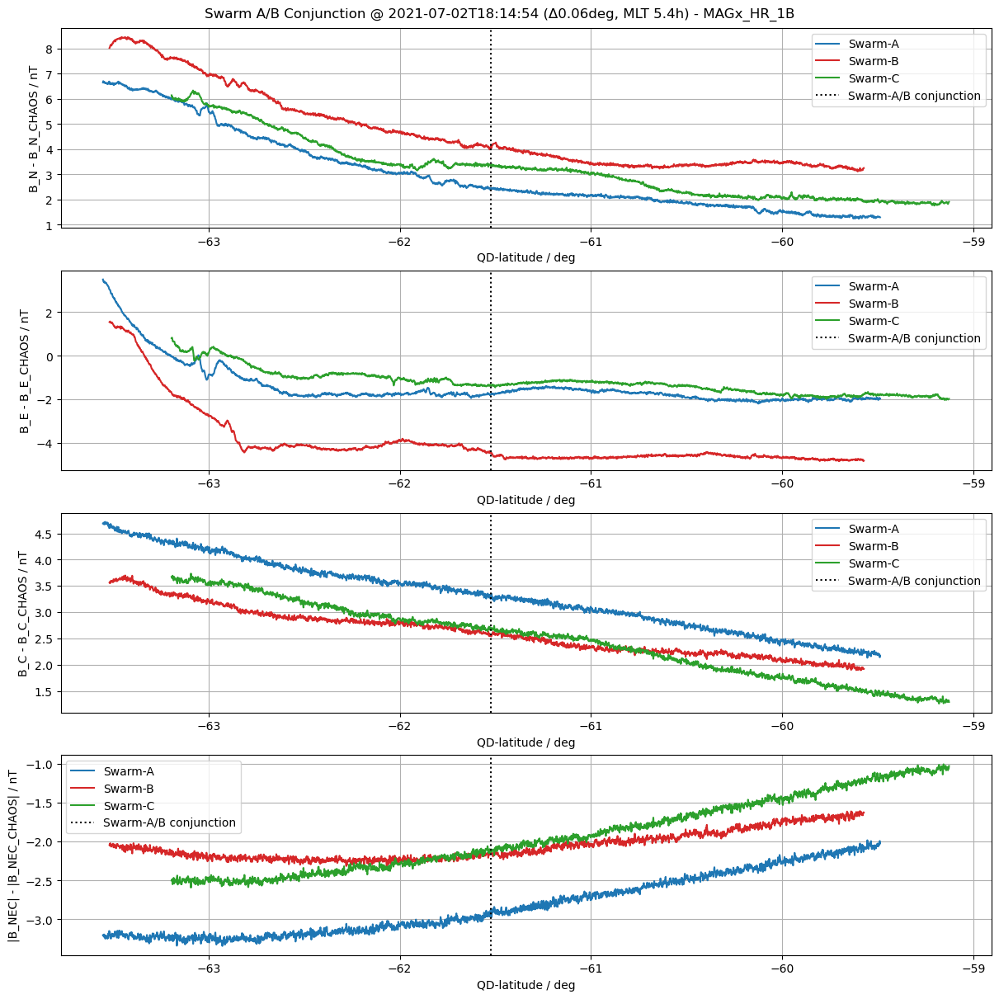

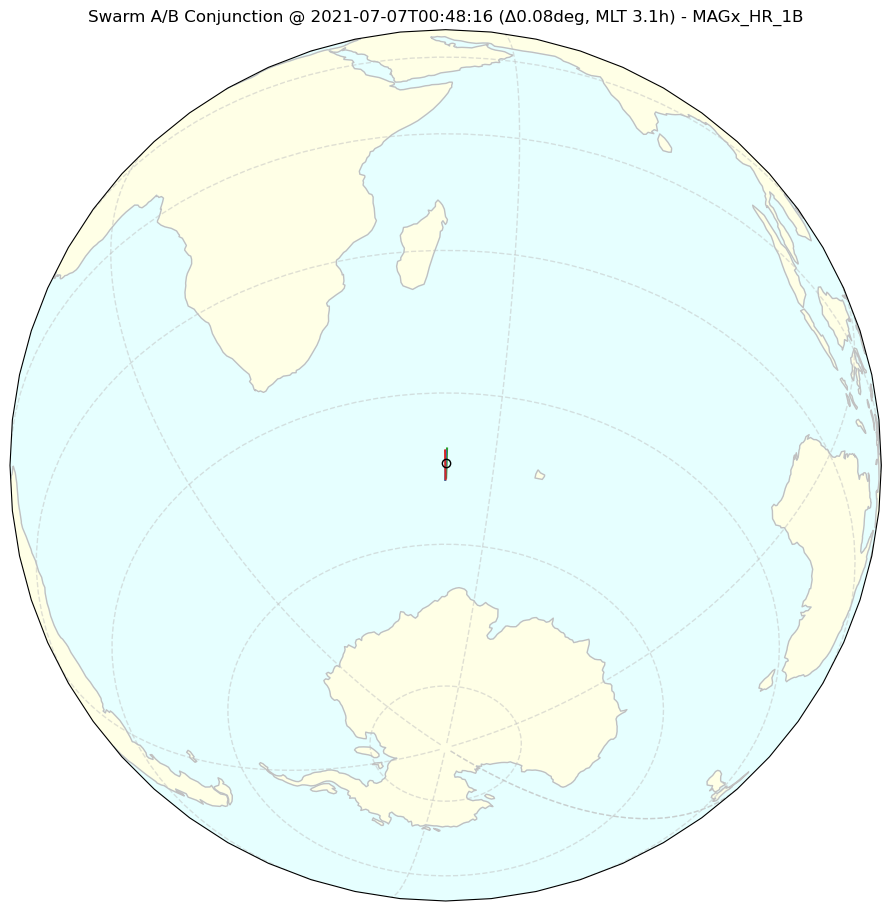

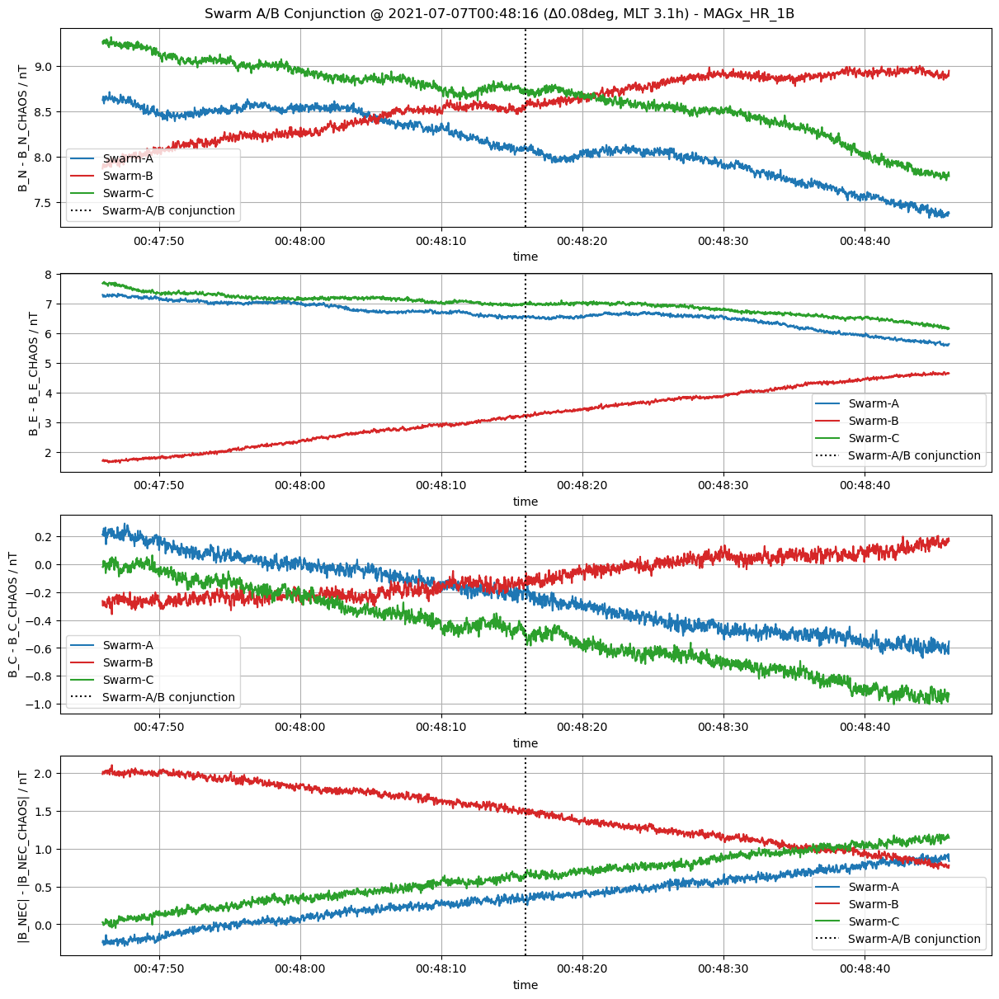

...

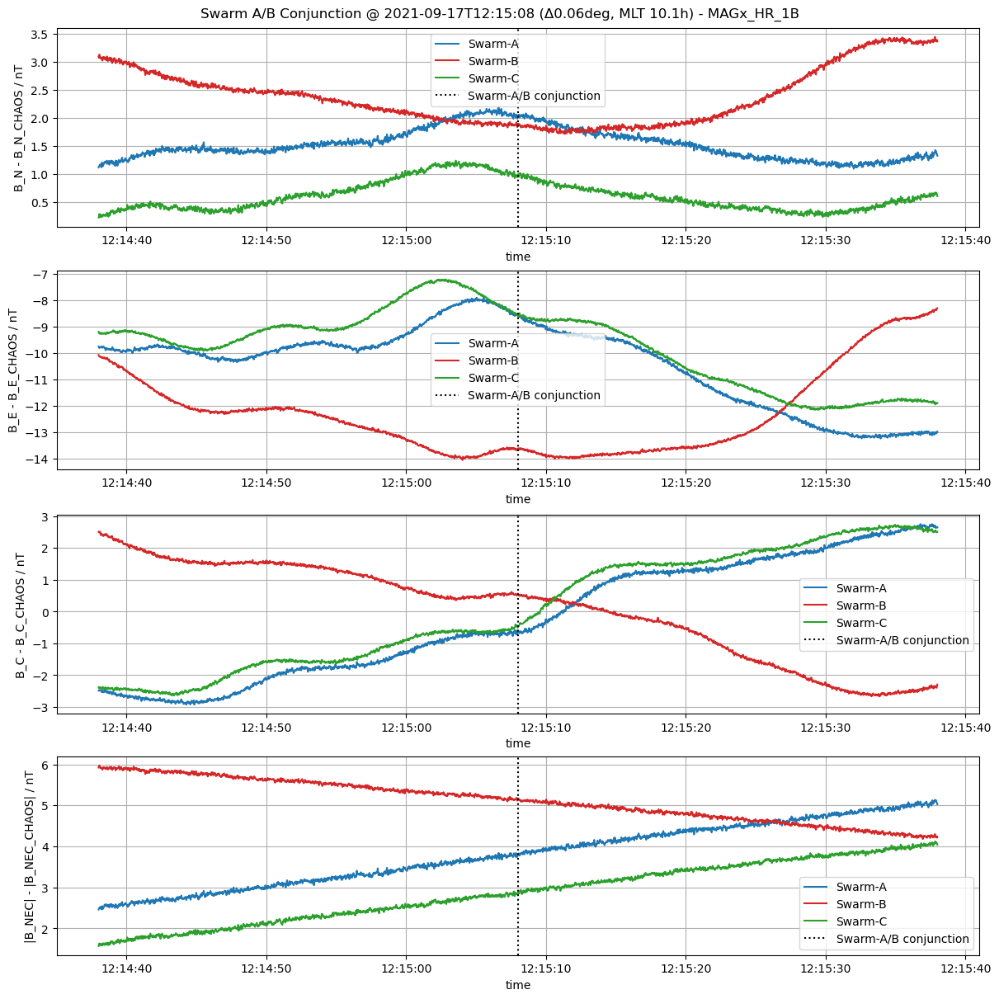

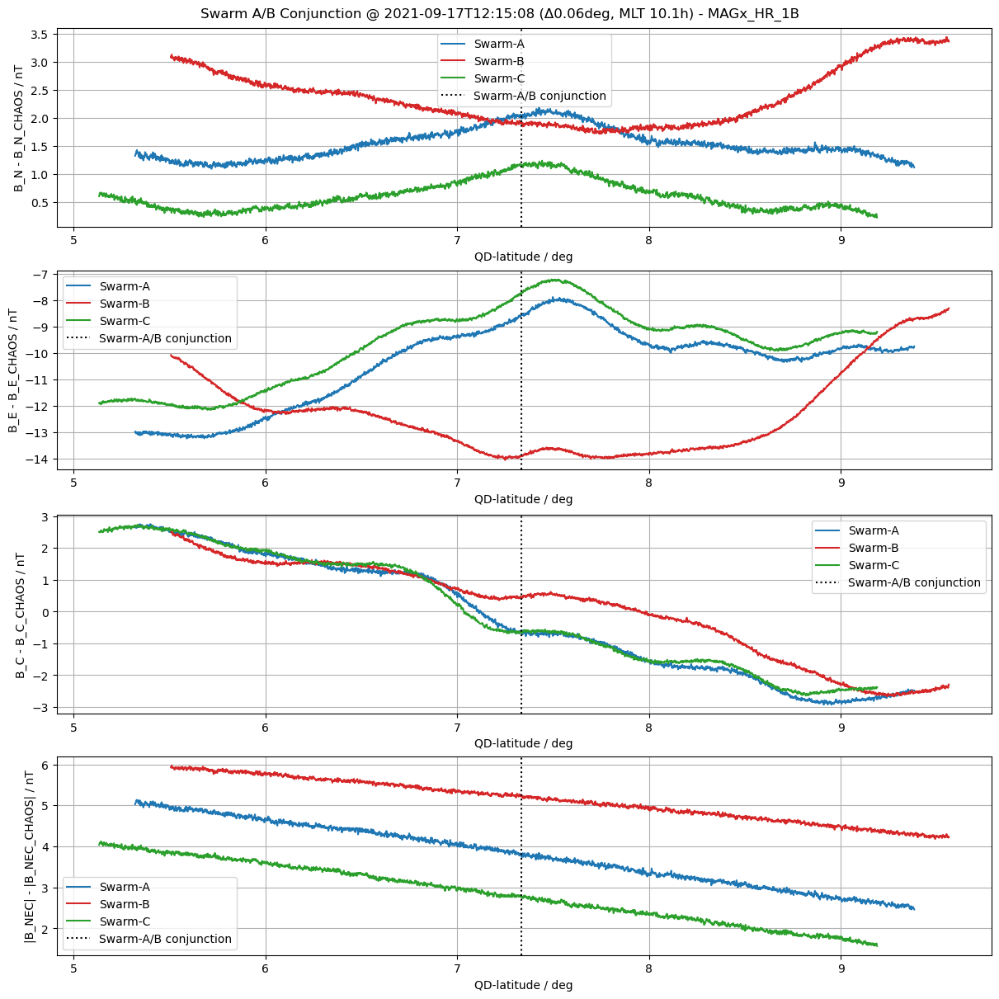

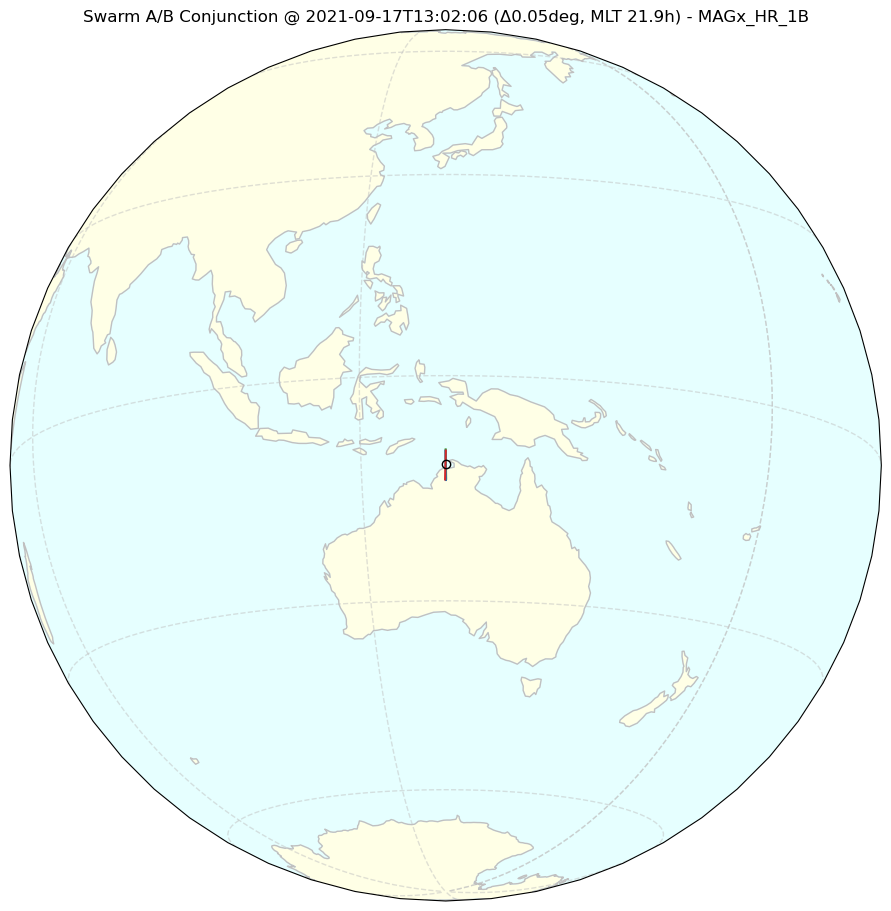

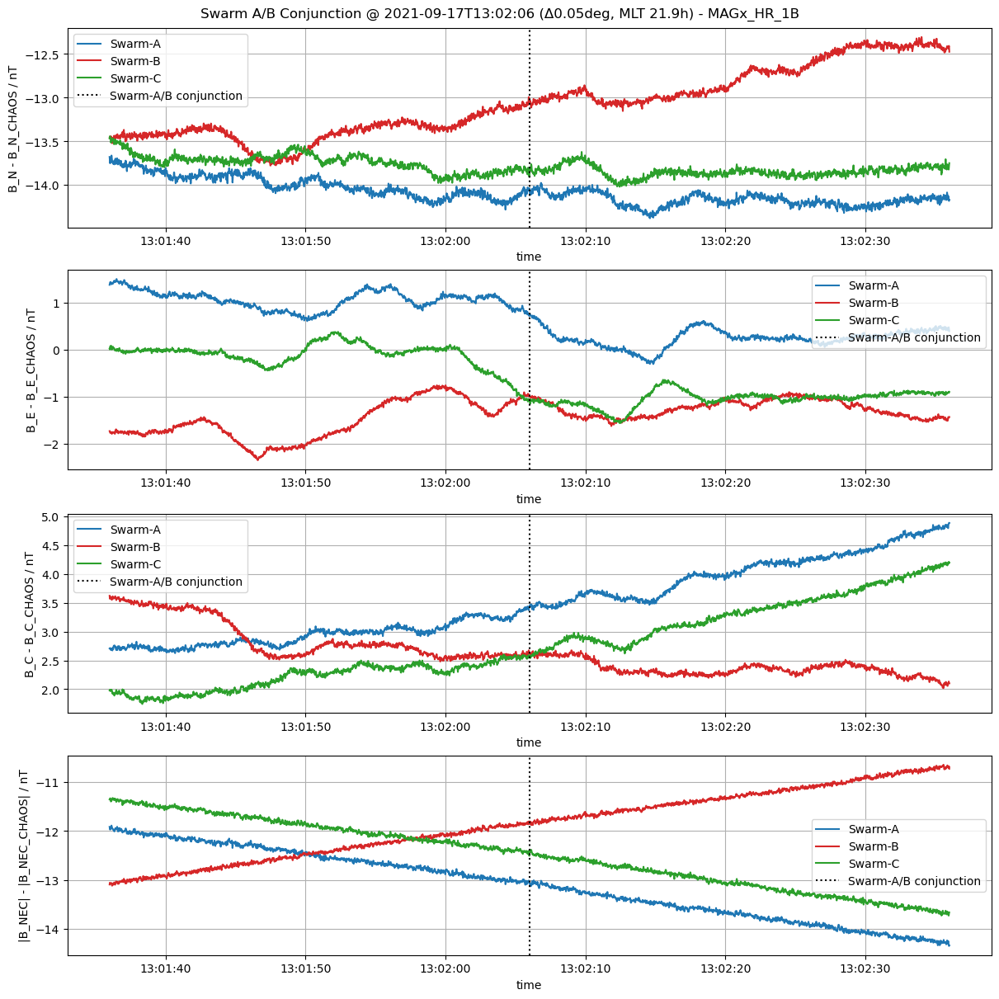

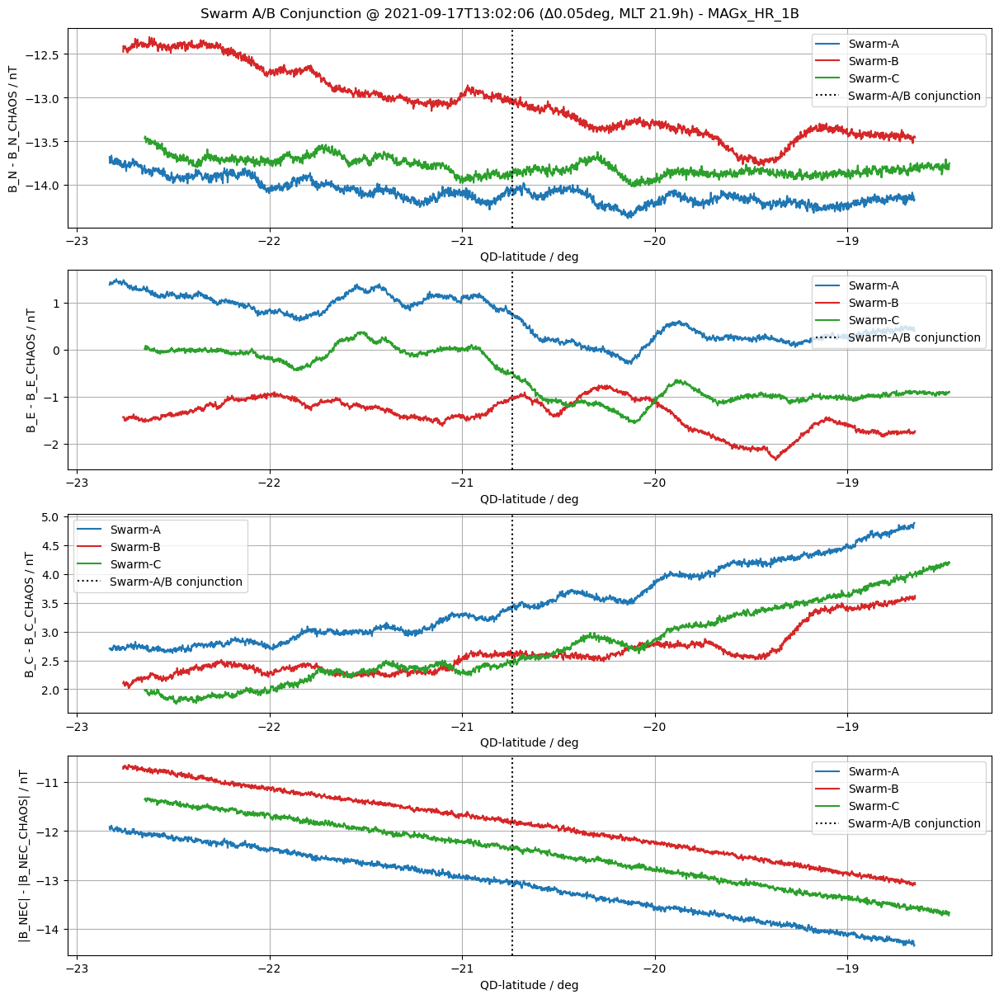

In [7]:
for item  in data:
    plot_conjunction_map(*item)
    plot_conjunction_time(*item)
    plot_conjunction_qdlat(*item)